## Analyzing the performance of WFLOW for two Brazilian catchments
*by R.S. de Wildt*

This document analyses the performance of WFLOW for two catchments located in the Amazon area of Brazil. The performance of WFLOW is determined by how well the output of river discharge matches with the observed discharge from CAMELS-BR. The code in this document is hidden to improve the readability of this document. The complete (unhidden) script can be found at : GITHUB LINK. 

The first cells are used to prepare all inputs for the analysis. Observed (measured) data from the dataset CAMELS-BR (https://zenodo.org/record/3964745#.YmfxBtpBw2w) is read and output is generated by the model WFLOW. 

The analysis starts at subchapter "Analysis on WFLOW".

#### Prepare script

In [1]:
# Import modules for model
import ewatercycle.forcing
import ewatercycle.models
import ewatercycle.parameter_sets

# Import modules for operations
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
import glob
import pickle
import xarray
import os
import netCDF4 as nc
from pathlib import Path

#Import modules for visualization
import plotly.graph_objs as go
import plotly.express as px
from plotly.subplots import make_subplots
from plotly import tools


/opt/conda/envs/ewatercycle/lib/python3.9/site-packages/esmvalcore/experimental/_warnings.py:13: UserWarning: 
  Thank you for trying out the new ESMValCore API.
  Note that this API is experimental and may be subject to change.
  More info: https://github.com/ESMValGroup/ESMValCore/issues/498


#### Dataprocessing : Observed forcing and discharge

In [2]:
Q_observed= []
P_observed= []
E_observed= []
T_observed= []
Catchment_list_observed = []

#create empty array to append later. Will hold strings with file names and paths.

for root, dirs, files in os.walk(r"Discharge"): #path to folder
    files.sort()
    for filename in files:
        file_path = os.path.join(root, filename)
        q= open(file_path)
        Q_observed.append(q)

for root, dirs, files in os.walk(r"Precipitation"): #path to folder
    files.sort()
    for filename in files:
        file_path = os.path.join(root, filename)
        p= open(file_path)
        P_observed.append(p)
        
        #A list of the selected basins is created for operations in later cells.
        Catchment_list_observed.append(filename[0:8])
        
for root, dirs, files in os.walk(r"Evaporation"): #path to folder
    files.sort()
    for filename in files:
        file_path = os.path.join(root, filename)
        e= open(file_path)
        E_observed.append(e)
        
for root, dirs, files in os.walk(r"Temperature"): #path to folder
    files.sort()
    for filename in files:
        file_path = os.path.join(root, filename)
        t= open(file_path)
        T_observed.append(t)

In [3]:
Overview_observed_daily = []

for i in range(0,len(P_observed)):
    p = pd.read_csv(P_observed[i].name, delimiter=' ', header=None, skiprows=1, names=['year','month','day','precipitation_cpc'])
    p.columns = p.columns.str.replace(' ', ',')
    p.loc[:,'dt'] = pd.to_datetime(p[['year', 'month', 'day']])
    p.index = p['dt']
    p.columns = ['year', 'month', 'day','Rain','dt']
    p = p.loc[(p.index.year>=2000)]
    
    q = pd.read_csv(Q_observed[i].name, delimiter=' ', header=None, skiprows=1, names=['year','month','day','streamflow_m3s', 'qual_control_by_ana', 'qual_flag'])
    q.columns = q.columns.str.replace(' ', ',')
    q.loc[:,'dt'] = pd.to_datetime(q[['year', 'month', 'day']])
    q.index = q['dt']
    q.columns = ['year', 'month', 'day','Discharge','Quality','Flag','dt']
    q = q.loc[(q.index.year>=2000)]
   
    e = pd.read_csv(E_observed[i].name, delimiter=' ', header=None, skiprows=1, names=['year','month','day','evapotransp_gleam'])
    e.columns = e.columns.str.replace(' ', ',')
    e.loc[:,'dt'] = pd.to_datetime(e[['year', 'month', 'day']])
    e.index = e['dt']
    e.columns = ['year', 'month', 'day','ET','dt']
    e = e.loc[(e.index.year>=2000)]
    
    t = pd.read_csv(T_observed[i].name, delimiter=' ', header=None, skiprows=1, names=['year','month','day','temperature_mean'])
    t.columns = t.columns.str.replace(' ', ',')
    t.loc[:,'dt'] = pd.to_datetime(t[['year', 'month', 'day']])
    t.index = t['dt']
    t.columns = ['year', 'month', 'day','Temperature_mean','dt']
    t = t.loc[(t.index.year>=2000)]
    
    River = pd.DataFrame()
    River['Q'] = q['Discharge'].interpolate(limit=5)
    River['P'] = p['Rain'].interpolate(limit=5)
    River['E'] = e['ET'].interpolate(limit=5)
    River['T'] = t['Temperature_mean'].interpolate(limit=5)
    River['ln(Q)'] = np.log(q['Discharge'])
    Overview_observed_daily.append(River)

/opt/conda/envs/ewatercycle/lib/python3.9/site-packages/pandas/core/arraylike.py:364: RuntimeWarning:

divide by zero encountered in log



#### Dataprocessing: Model forcing

In [4]:
#Catchment 31520000
forcing_3152 = pd.DataFrame()
pr_3152= pd.read_csv('Forcing_GL/31520000_mean_precip_2000_2016.csv')
pet_3152= pd.read_csv('Forcing_GL/31520000_mean_pet_2000_2016.csv')
tas_3152= pd.read_csv('Forcing_GL/31520000_mean_tas_2000_2016.csv')
pr_3152['time'] = pd.to_datetime(pr_3152['time'])
forcing_3152.index = pr_3152['time']
forcing_3152['pr'] = pr_3152['pr'].values
forcing_3152['pet'] = pet_3152['pet'].values
forcing_3152['tas'] = tas_3152['tas'].values
forcing_3152 = forcing_3152.loc[(forcing_3152.index.year>=2000)]
forcing_3152 = forcing_3152.loc[(forcing_3152.index.year<=2016)]

#Catchment 66260001
forcing_6626 = pd.DataFrame()
pr_6626= pd.read_csv('Forcing_GL/66260001_mean_precip_2000_2016.csv')
pet_6626= pd.read_csv('Forcing_GL/66260001_mean_pet_2000_2016.csv')
tas_6626= pd.read_csv('Forcing_GL/66260001_mean_tas_2000_2016.csv')
pr_6626['time'] = pd.to_datetime(pr_6626['time'])
forcing_6626.index = pr_6626['time']
forcing_6626['pr'] = pr_6626['pr'].values
forcing_6626['pet'] = pet_6626['pet'].values
forcing_6626['tas'] = tas_6626['tas'].values
forcing_6626 = forcing_6626.loc[(forcing_6626.index.year>=2000)]
forcing_6626 = forcing_6626.loc[(forcing_6626.index.year<=2016)]

In [5]:
#Open lists generated by different script (not included in this folder).

with open ('/home/rdewildt/backupHPC/user46/RogierThesis/RWildt_Wflow/Input_spatial/target_longitudes.ob', 'rb') as lo:
    target_longitudes = pickle.load(lo)
with open ('/home/rdewildt/backupHPC/user46/RogierThesis/RWildt_Wflow/Input_spatial/target_latitudes.ob', 'rb') as la:
    target_latitudes = pickle.load(la)
with open ('/home/rdewildt/backupHPC/user46/RogierThesis/RWildt_Wflow/Input_spatial/basin_list.ob', 'rb') as bl:
    basin_list = pickle.load(bl)
with open ('/home/rdewildt/backupHPC/user46/RogierThesis/RWildt_Wflow/TS_observed_q.ob', 'rb') as pr:
    TS_observed_q = pickle.load(pr)
with open ('/home/rdewildt/backupHPC/user46/RogierThesis/RWildt_Wflow/TS_model_q_standard.ob', 'rb') as ms:
    TS_model_q_standard = pickle.load(ms)

In [6]:
#Edit bad values for longitudes and latitudes. The coordinates of some catchments were located on land, resulting in zero values for discharge.

#Catchment 32400000
target_longitudes[3]= -46.705
target_latitudes[3]= -1.850

#Catchment 54260000
target_longitudes[15]= -42.810 
target_latitudes[15]= -17.292

#Catchment 66260001
target_longitudes[17]= -56.127
target_latitudes[17]= -15.633

In [7]:
#Select two basins for this analysis
basin_list_subset = [basin_list[1], basin_list[17]]
target_longitudes_subset = [target_longitudes[1], target_longitudes[17]]
target_latitudes_subset = [target_latitudes[1], target_latitudes[17]]

#### Set up the model

In [5]:
# load config file.
ewatercycle.CFG.load_from_file('/home/rdewildt/backupHPC/user46/RogierThesis/RWildt_Wflow/ewatercycle_RdeWildt.yml')

In [6]:
# Abbreviation for strings: F'{VARIABELE}'.

BASINDIR = '/home/rdewildt/backupHPC/user46/RogierThesis/RWildt_Wflow/Parametersets/camels_BR/'
SHAPEDIR = '/home/rdewildt/backupHPC/user46/RogierThesis/RWildt_Wflow/Forcing/Shapefiles/'

In [7]:
Parametersets = []

for id in basin_list_subset:
    custom_parameter_set = ewatercycle.parameter_sets.ParameterSet(
    name="custom_parameter_set",
    directory=f"{BASINDIR}/{id}",
    config=f"{BASINDIR}/{id}/wflow_sbm_model_GL.ini",
    target_model="wflow",
    supported_model_versions={"2020.1.2"},
    )
    Parametersets.append(custom_parameter_set)


In [9]:
Forcingsets = []

for id in basin_list_subset:
    forcing = ewatercycle.forcing.load_foreign(
    directory=f"/home/rdewildt/backupHPC/user46/RogierThesis/RWildt_Wflow/Forcing_GL/",
    target_model="wflow",
    start_time="2000-01-01T00:00:00Z",
    end_time="2010-12-31T00:00:00Z",
    forcing_info=dict(
        # Additional information about the external forcing data needed for the model configuration
        netcdfinput=f"wflow_ERA5_MSWEP_{id}.nc",
        Precipitation="/pr",
        EvapoTranspiration="/pet",
        Temperature="/tas",
    ),)
    Forcingsets.append(forcing)

In [10]:
#The model is run for each catchment in a loop. The second part of the loop retrieves the results.
Model_results = []
model_dict = {}

for i in range(len(basin_list_subset)):
    model_dict[f'basin_{i}'] = ewatercycle.models.Wflow(
    version="2020.1.2", parameter_set=Parametersets[i], forcing=Forcingsets[i])
    
    cfg_file, cfg_dir = model_dict[f'basin_{i}'].setup()
    model_dict[f'basin_{i}'].initialize(cfg_file)
    
    time = pd.date_range(model_dict[f'basin_{i}'].start_time_as_isostr, model_dict[f'basin_{i}'].end_time_as_isostr)
    timeseries = pd.DataFrame(index=pd.Index(time, name="time"), columns=["RiverRunoff","LnQ"])
    #print(len(basin_list))
    lon = target_longitudes_subset[i]
    lat = target_latitudes_subset[i]
    print(lon)
    
    #Second part of loop: Retrieve discharge and append in list Model_results.
    while model_dict[f'basin_{i}'].time < model_dict[f'basin_{i}'].end_time:
            model_dict[f'basin_{i}'].update()
            #print(lat)
            # Track discharge at station location
            discharge = model_dict[f'basin_{i}'].get_value_at_coords("RiverRunoff", [lat], [lon])
            time = model_dict[f'basin_{i}'].time_as_isostr
            timeseries["RiverRunoff"][time] = discharge
            timeseries["RiverRunoff"] = timeseries["RiverRunoff"].astype(float)
            #timeseries["Cr"] = 
            timeseries["LnQ"] = np.log(timeseries["RiverRunoff"])
            print(f"Current time: {model_dict[f'basin_{i}'].time_as_isostr}", end="\r")
    Model_results.append(timeseries)
#model_dict[f'basin_{i}'].finalize() -> Results in error. 

-47.0656
-56.127 time: 2010-12-31T00:00:00Z


#### Run the model

In [ ]:
Model_results = []

for i in range(len(basin_list_subset)):


    while model_dict[f'basin_{i}'].time < model_dict[f'basin_{i}'].end_time:
        model_dict[f'basin_{i}'].update()
        
        # Track discharge at station location
        Discharge = model_dict[f'basin_{i}'].get_value_at_coords("RiverRunoff", [lat], [lon])

  
        time = model_dict[f'basin_{i}'].time_as_isostr
        
        #
        timeseries["RiverRunoff"][time] = Discharge
        timeseries["RiverRunoff"] = timeseries["RiverRunoff"].astype(float)
        timeseries["LnQ"] = np.log(timeseries["RiverRunoff"])
            
        print(f"Current time: {model_dict[f'basin_{i}'].time_as_isostr}", end="\r")
    Model_results.append(timeseries)
    

## Analysis on WFLOW

The two catchments "Bom Jardim" and "Cuiaba Paraguay" are two catchments in our study area in Brazil. They differ on many parameters like area size, mean precipitation and dominant landcover. They have common that they are both subject to heavy deforestation (respectively 31% and 19%).

#### Model callibration
First the model is callibrated on the parameter "KsatHorFrac". This parameter is defined as: "A multiplication factor [-] applied to KsatVer for the horizontal saturated conductivity used for computing lateral subsurface flow." (https://wflow.readthedocs.io/en/latest/wflow_sbm.html?highlight=ksathorfrac).  Figure 1 shows a selection of discharge output generated by WFLOW with different values for KsatHorFrac.

In [8]:
Discharge_3152_callibration = pd.read_csv('31520000_calibration_simulation_results_dataframe.csv')
Discharge_6626_callibration = pd.read_csv('66260001_calibration_simulation_results_dataframe.csv')
Discharge_3152_callibration.index = Discharge_3152_callibration['time']
Discharge_6626_callibration.index = Discharge_6626_callibration['time']

Observed_3152_callibration = pd.read_csv('31520000_calibration_observation_results_dataframe.csv')
Observed_6626_callibration = pd.read_csv('66260001_calibration_observation_results_dataframe.csv')
Observed_3152_callibration.index = Observed_3152_callibration['time']
Observed_6626_callibration.index = Observed_6626_callibration['time']


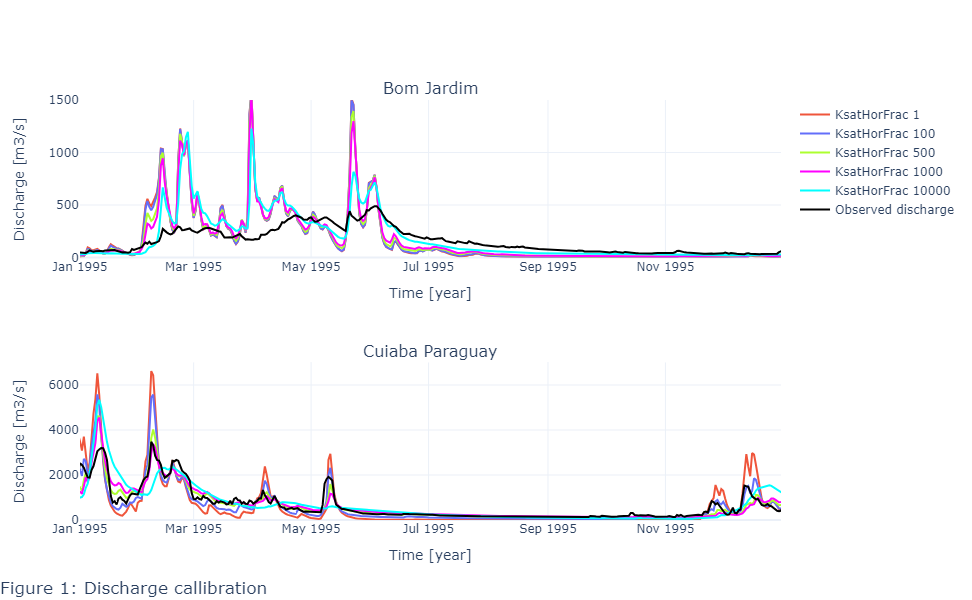

In [9]:


fig_cal = make_subplots(rows=2, cols=1, subplot_titles=("Bom Jardim", "Cuiaba Paraguay"))

fig_cal.add_trace(go.Scatter(
    y=Discharge_3152_callibration['KsatHorFrac_1_Q'],
    x=Discharge_3152_callibration.index,
    mode='lines',
    name='KsatHorFrac 1',
    marker_color = '#EF553B',
), row=1, col=1)

#fig_cal.add_trace(go.Scatter(
#    y=Discharge_3152_callibration['KsatHorFrac_25_Q'],
#    x=Discharge_3152_callibration.index,
#    mode='lines',
#    name='KsatHorFrac 25',
#), row=1, col=1)

#fig_cal.add_trace(go.Scatter(
#    y=Discharge_3152_callibration['KsatHorFrac_50_Q'],
#    x=Discharge_3152_callibration.index,
#    mode='lines',
#    name='KsatHorFrac 50',
#), row=1, col=1)

fig_cal.add_trace(go.Scatter(
    y=Discharge_3152_callibration['KsatHorFrac_100_Q'],
    x=Discharge_3152_callibration.index,
    mode='lines',
    name='KsatHorFrac 100',
    marker_color = '#636EFA',
), row=1, col=1)

#fig_cal.add_trace(go.Scatter(
#    y=Discharge_3152_callibration['KsatHorFrac_250_Q'],
#    x=Discharge_3152_callibration.index,
#    mode='lines',
#    name='KsatHorFrac 250',
#), row=1, col=1)

fig_cal.add_trace(go.Scatter(
    y=Discharge_3152_callibration['KsatHorFrac_500_Q'],
    x=Discharge_3152_callibration.index,
    mode='lines',
    name='KsatHorFrac 500',
    marker_color = 'greenyellow',
), row=1, col=1)

fig_cal.add_trace(go.Scatter(
    y=Discharge_3152_callibration['KsatHorFrac_1000_Q'],
    x=Discharge_3152_callibration.index,
    mode='lines',
    name='KsatHorFrac 1000',
    marker_color = 'fuchsia',
), row=1, col=1)

#fig_cal.add_trace(go.Scatter(
#    y=Discharge_3152_callibration['KsatHorFrac_5000_Q'],
#    x=Discharge_3152_callibration.index,
#    mode='lines',
#    name='KsatHorFrac 5000',
#), row=1, col=1)

fig_cal.add_trace(go.Scatter(
    y=Discharge_3152_callibration['KsatHorFrac_10000_Q'],
    x=Discharge_3152_callibration.index,
    mode='lines',
    name='KsatHorFrac 10000',
    marker_color = 'cyan',
), row=1, col=1)

#fig_cal.add_trace(go.Scatter(
#    y=Discharge_3152_callibration['KsatHorFrac_20000_Q'],
#    x=Discharge_3152_callibration.index,
#    mode='lines',
#    name='KsatHorFrac 20000',
#), row=1, col=1)

#fig_cal.add_trace(go.Scatter(
#    y=Discharge_3152_callibration['KsatHorFrac_50000_Q'],
#    x=Discharge_3152_callibration.index,
#    mode='lines',
#    name='KsatHorFrac 50000',
#), row=1, col=1)

fig_cal.add_trace(go.Scatter(
    y= Observed_3152_callibration['streamflow_m3s'],
    x=Observed_3152_callibration.index,
    mode='lines',
    name='Observed discharge',
    marker_color = 'black',
), row=1, col=1)

fig_cal.add_trace(go.Scatter(
    y=Discharge_6626_callibration['KsatHorFrac_1_Q'],
    x=Discharge_6626_callibration.index,
    mode='lines',
    name='KsatHorFrac 1',
    marker_color = '#EF553B',
    showlegend=False
), row=2, col=1)

#fig_cal.add_trace(go.Scatter(
#    y=Discharge_6626_callibration['KsatHorFrac_25_Q'],
#    x=Discharge_6626_callibration.index,
#    mode='lines',
#    name='KsatHorFrac 25',
#    showlegend=False
#), row=2, col=1)

#fig_cal.add_trace(go.Scatter(
#    y=Discharge_6626_callibration['KsatHorFrac_50_Q'],
#    x=Discharge_6626_callibration.index,
#    mode='lines',
#    name='KsatHorFrac 50',
#    showlegend=False
#), row=2, col=1)

fig_cal.add_trace(go.Scatter(
    y=Discharge_6626_callibration['KsatHorFrac_100_Q'],
    x=Discharge_6626_callibration.index,
    mode='lines',
    name='KsatHorFrac 100',
    marker_color = '#636EFA',
    showlegend=False
), row=2, col=1)

#fig_cal.add_trace(go.Scatter(
#    y=Discharge_6626_callibration['KsatHorFrac_250_Q'],
#    x=Discharge_6626_callibration.index,
#    mode='lines',
#    name='KsatHorFrac 250',
#    showlegend=False
#), row=2, col=1)

fig_cal.add_trace(go.Scatter(
    y=Discharge_6626_callibration['KsatHorFrac_500_Q'],
    x=Discharge_6626_callibration.index,
    mode='lines',
    name='KsatHorFrac 500',
    marker_color = 'greenyellow',
    showlegend=False
), row=2, col=1)

fig_cal.add_trace(go.Scatter(
    y=Discharge_6626_callibration['KsatHorFrac_1000_Q'],
    x=Discharge_6626_callibration.index,
    mode='lines',
    name='KsatHorFrac 1000',
    marker_color = 'fuchsia',
    showlegend=False
), row=2, col=1)

#fig_cal.add_trace(go.Scatter(
#    y=Discharge_6626_callibration['KsatHorFrac_5000_Q'],
#    x=Discharge_6626_callibration.index,
#    mode='lines',
#    name='KsatHorFrac 5000',
#    showlegend=False
#), row=2, col=1)

fig_cal.add_trace(go.Scatter(
    y=Discharge_6626_callibration['KsatHorFrac_10000_Q'],
    x=Discharge_6626_callibration.index,
    mode='lines',
    name='KsatHorFrac 10000',
    marker_color = 'cyan',
    showlegend=False
), row=2, col=1)

#fig_cal.add_trace(go.Scatter(
#    y=Discharge_6626_callibration['KsatHorFrac_20000_Q'],
#    x=Discharge_6626_callibration.index,
#    mode='lines',
#    name='KsatHorFrac 20000',
#    showlegend=False
#), row=2, col=1)

#fig_cal.add_trace(go.Scatter(
#    y=Discharge_6626_callibration['KsatHorFrac_50000_Q'],
#    x=Discharge_6626_callibration.index,
#    mode='lines',
#    name='KsatHorFrac 50000',
#    showlegend=False
#), row=2, col=1)

fig_cal.add_trace(go.Scatter(
    y=Observed_6626_callibration['streamflow_m3s'],
    x=Observed_6626_callibration.index,
    mode='lines',
    name='Observed discharge',
    marker_color = 'black',
    showlegend=False
), row=2, col=1)

fig_cal['layout']['xaxis']['title']='Time [year]'
fig_cal['layout']['xaxis2']['title']='Time [year]'
fig_cal['layout']['yaxis']['title']='Discharge [m3/s]'
fig_cal['layout']['yaxis2']['title']='Discharge [m3/s]'

#fig_Q.update_yaxes(title= 'Q (m3/s)')
fig_cal.update_xaxes(range=["1995-01-01", "1995-12-31"])
fig_cal.update_yaxes(range=["0", "1500"], row=1, col=1 )
fig_cal.update_yaxes(range=["0", "7000"], row=2, col=1 )
fig_cal.update_layout(template='plotly_white', height=600, width=950, title = dict(x = 0, y=0.01, text = 'Figure 1: Discharge callibration'))



<u>What do we see?<u>
    
None of the values of KsatHorFrac result in a decent output for discharge. In general higher KsatHorFrac lead to smaller peaks and larger baseflow. The lateral ground flow becomes larger when KsatHorFrac becomes larger. More lateral groundflow means the ground will be less saturated and thus able to absorb more rain, resulting in lower discharge peaks. The lateral groundflow eventually contributes to the discharge of the river. Through this contribution, more lateral groundflow results in a larger baseflow.

#### Output: callibrated discharge
The discharge after callibration is displayed in figure 2. The KsatHorFrac of Bom Jardim is IETS and the value for KsatHorfrac of Cuiaba Paraguay is IETS.

In [10]:
#Discharge generated by WFLOW
run_number_3152 = '20220425_083912'
run_number_6626 = '20220425_084945'
Discharge_3152 =  pd.read_csv('wflow_'+run_number_3152+'/run_default/run.csv')
Discharge_6626 =  pd.read_csv('wflow_'+run_number_6626+'/run_default/run.csv')

#Observed discharge from CAMELS-BR
Discharge_3152_observed = pd.read_csv('31520000_evaluation_observation_results_dataframe.csv')
Discharge_6626_observed = pd.read_csv('66260001_evaluation_observation_results_dataframe.csv')
Discharge_3152_observed.index = Discharge_3152_observed['time']
Discharge_6626_observed.index = Discharge_6626_observed['time']

#Callibrated discharge
Discharge_3152_cal= pd.read_csv('31520000_evaluation_simulation_results_dataframe.csv')
Discharge_6626_cal= pd.read_csv('66260001_evaluation_simulation_results_dataframe.csv')
Discharge_3152_cal.index = Discharge_3152_cal['time']
Discharge_6626_cal.index = Discharge_6626_cal['time']

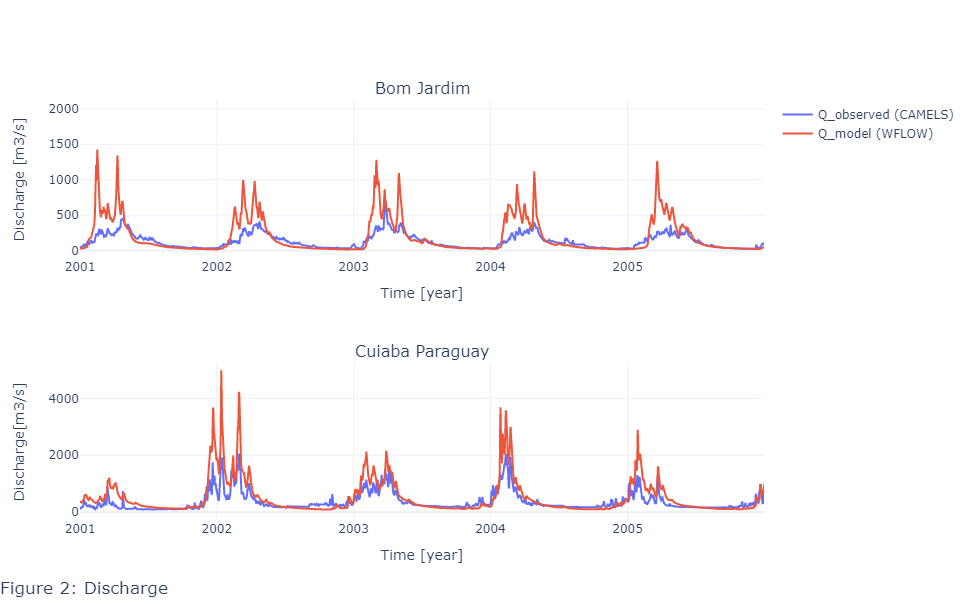

In [11]:


fig_Q = make_subplots(rows=2, cols=1, subplot_titles=("Bom Jardim", "Cuiaba Paraguay"))

fig_Q.add_trace(go.Scatter(
    y=Discharge_3152_observed['streamflow_m3s'],
    x=Discharge_3152_observed.index,
    mode='lines',
    name='Q_observed (CAMELS)',
    marker_color = '#636EFA'
), row=1, col=1)

fig_Q.add_trace(go.Scatter(
    y=Discharge_3152_cal['31520000_Q'],
    x=Discharge_3152_cal.index,
    mode='lines',
    name='Q_model (WFLOW)',
    marker_color = '#EF553B'
), row=1, col=1)

fig_Q.add_trace(go.Scatter(
    y=Discharge_6626_observed['streamflow_m3s'],
    x=Discharge_6626_observed.index,
    mode='lines',
    name='Q_observed (CAMELS)',
    marker_color = '#636EFA',
    showlegend=False
), row=2, col=1)

fig_Q.add_trace(go.Scatter(
    y=Discharge_6626_cal['66260001_Q'],
    x=Discharge_6626_cal.index,
    mode='lines',
    name='Q_model_callibrated (WFLOW)',
    marker_color = '#EF553B',
    showlegend=False
), row=2, col=1)

fig_Q['layout']['xaxis']['title']='Time [year]'
fig_Q['layout']['xaxis2']['title']='Time [year]'
fig_Q['layout']['yaxis']['title']='Discharge [m3/s]'
fig_Q['layout']['yaxis2']['title']='Discharge[m3/s]'
#fig_Q.update_yaxes(title= 'Q (m3/s)')
fig_Q.update_xaxes(range=["2001-01-01", "2005-12-31"])
fig_Q.update_layout(template='plotly_white', height=600, width=950, title = dict(x = 0, y=0.01, text = 'Figure 2: Discharge'))



<u>What do we see?<u>
    
The first observation regards the height of the discharge peaks. Even after callibration the discharge peaks in WFLOW show a severe overestimation in comparison with the measured river discharge. A second observation regards the steepness of the discharge peaks. The peaks are much steeper than the peaks observed by CAMELS-BR. This larger steepness means that runoff generated by precipitation reaches the river faster. Ergo, the concentration time in WFLOW is smaller than the concentration time of the measured runoff. The recession of the discharge peaks is also steeper for the discharge calculated by WFLOW. The recession of discharge peaks can be used as indication for the ability of a catchment to retain water. A short/steep recession curve means that river discharge quickly recovers from peakflow to baseflow. In summary, our model overestimates the value and steepness of discharge peaks in our study area.

#### Precipitation

The steeper and higher discharge peaks observed in figure 1 can be caused by several factors. One of the most obvious factors is a difference in input like precipitation. For our model we use MSWEP as input for precipitation and the precipitation in CAMELS-BR is supplied by NOAA Climate Prediction Center (CPC). Figure 3 shows the daily precipitation of both datasets for the period 01-01-2000 to 31-12-2005 and figure 4 shows the cumulative yearly precipitation for the period 2000 to 2018.

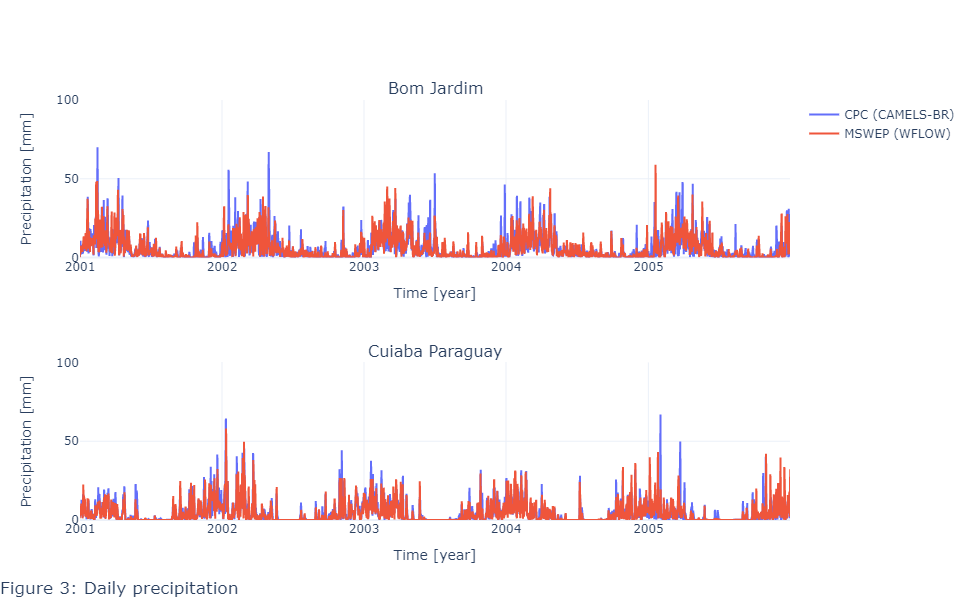

In [12]:
Observed_pr_3152 = Overview_observed_daily[1]['P']
Observed_pr_6626 = Overview_observed_daily[17]['P']
Model_pr_3152 = forcing_3152['pr']
Model_pr_6626 = forcing_6626['pr']

fig_pr = make_subplots(rows=2, cols=1, subplot_titles=("Bom Jardim", "Cuiaba Paraguay"))

fig_pr.add_trace(go.Scatter(
    y=Observed_pr_3152,
    x=Observed_pr_3152.index,
    mode='lines',
    name='CPC (CAMELS-BR)',
    marker_color = '#636EFA'
    
),row=1, col=1)

fig_pr.add_trace(go.Scatter(
    y=Model_pr_3152,
    x=Model_pr_3152.index,
    mode='lines',
    name='MSWEP (WFLOW)',
    marker_color = '#EF553B'
),row=1, col=1)

fig_pr.add_trace(go.Scatter(
    y=Observed_pr_6626,
    x=Observed_pr_6626.index,
    mode='lines',
    name='CPC (CAMELS-BR)',
    marker_color = '#636EFA',
    showlegend=False
    
),row=2, col=1)

fig_pr.add_trace(go.Scatter(
    y=Model_pr_6626,
    x=Model_pr_6626.index,
    mode='lines',
    name='MSWEP (WFLOW)',
    marker_color = '#EF553B',
    showlegend=False
),row=2, col=1)

fig_pr['layout']['xaxis']['title']='Time [year]'
fig_pr['layout']['xaxis2']['title']='Time [year]'
fig_pr['layout']['yaxis']['title']='Precipitation [mm]'
fig_pr['layout']['yaxis2']['title']='Precipitation [mm]'

fig_pr.update_xaxes(range=["2001-01-01", "2005-12-31"])
fig_pr.update_yaxes(range=["0", "100"])
fig_pr.update_layout(template='plotly_white', height=600, width=950, title = dict(x = 0, y=0.01, text = 'Figure 3: Daily precipitation'), 
                     )
fig_pr.show()

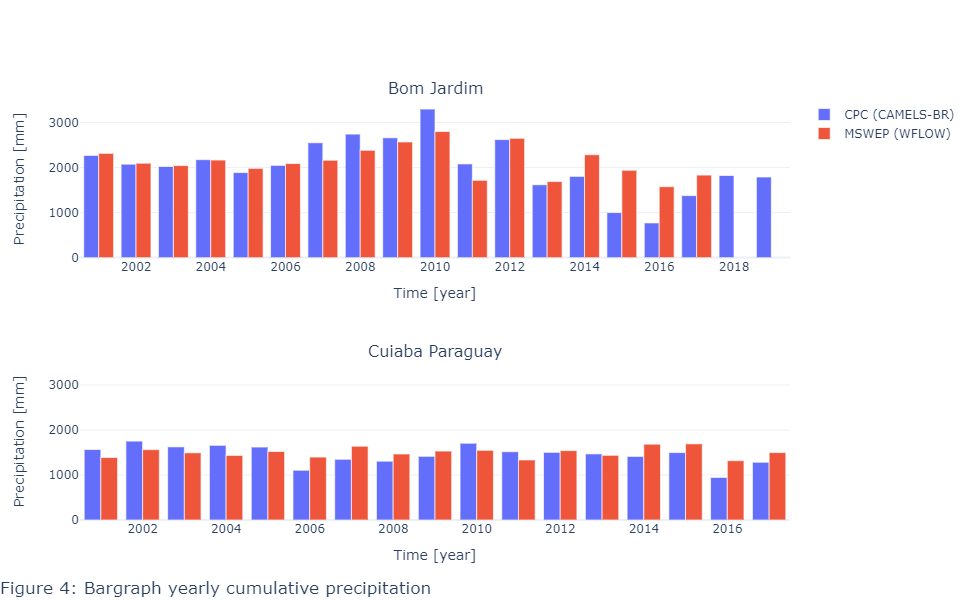

In [13]:
Observed_pr_year_3152 = Observed_pr_3152.resample('Y').sum()
Observed_pr_year_6626 = Observed_pr_6626.resample('Y').sum()
Model_pr_year_3152 = Model_pr_3152.resample('Y').sum()
Model_pr_year_6626 = Model_pr_6626.resample('Y').sum()


trace1 = go.Bar(
    x=Observed_pr_year_3152.index,
    y=Observed_pr_year_3152.values,
    name='CPC (CAMELS-BR)',
)
trace2 = go.Bar(
    x=Model_pr_year_3152.index,
    y=Model_pr_year_3152.values,
    name='MSWEP (WFLOW)',
)

trace3 = go.Bar(
    x=Observed_pr_year_6626.index,
    y=Observed_pr_year_6626.values,
    name='CPC (CAMELS-BR)',
    marker_color = '#636EFA',
    showlegend=False,
)
trace4 = go.Bar(
    x=Model_pr_year_6626.index,
    y=Model_pr_year_6626.values,
    name='MSWEP (WFLOW)',
    marker_color = '#EF553B',
    showlegend=False    
)

fig = make_subplots(rows=2, cols=1,subplot_titles=("Bom Jardim", "Cuiaba Paraguay") )

fig.append_trace(trace1,1,1)
fig.append_trace(trace2,1,1)
fig.append_trace(trace3,2,1)
fig.append_trace(trace4,2,1)

#fig.update_xaxes(range=["2000-01-01", "2014-12-31"])
fig.update_yaxes(range=["0", "3500"])
#fig.update_xaxes(range=["2000", "2017"])

fig['layout']['xaxis']['title']='Time [year]'
fig['layout']['xaxis2']['title']='Time [year]'
fig['layout']['yaxis']['title']='Precipitation [mm]'
fig['layout']['yaxis2']['title']='Precipitation [mm]'

fig['layout'].update(height=600, width=950, template='plotly_white', title = dict(x = 0, y=0.01, text = 'Figure 4: Bargraph yearly cumulative precipitation'))
fig

<u>What do we see?<u>
    
Figure 3 shows daily precipitation and is used to anaylze if there are deviations in height and timing of precipitation peaks. From this figure we observe that there are some differences between the two datasets. However, these differences are not significant and can be regarded as outliers. Figure 4 illustrates the cumulative yearly precipitation as a bar chart. This figure 4 is used to analyze if there are large yearly deviations in precipitation for the entire scope 2000-2018. From this figure we observe that the deviations between both datasets are minor . In conclusion, differences in precipitation input are not significant enough to be the cause of the performance of our model.

### Evapotranspiration & Temperature

Our model has three inputs of forcing: Precipitation, Evapotranspiration and Temperature. It is concluded that precipitation is not the cause of the bad performance of our model. This leaves Potential Evapotransipiration (PET) and Temperature (TAS) as possible factors for deviations between the output of WFLOW and the observed discharge of CAMELS-BR. Figure 5 shows the daily PET of both datasets. This figure is shortly analyzed before looking at figure 6, which shows the PET and TAS of both datasets as PET and temperature are related to each other.

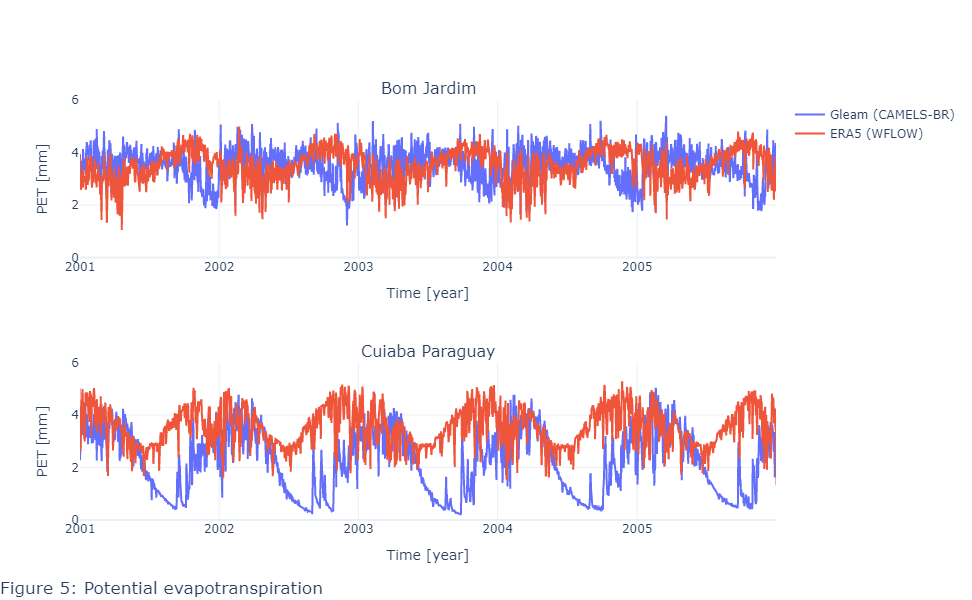

In [14]:
Observed_pet_3152 = Overview_observed_daily[1]['E']
Observed_pet_6626 = Overview_observed_daily[9]['E']
Model_pet_3152 = forcing_3152['pet']
Model_pet_6626 = forcing_6626['pet']

fig_pet = make_subplots(rows=2, cols=1, subplot_titles=("Bom Jardim", "Cuiaba Paraguay"))

fig_pet.add_trace(go.Scatter(
    y=Observed_pet_3152,
    x=Observed_pet_3152.index,
    mode='lines',
    name='Gleam (CAMELS-BR)',
    marker_color = '#636EFA'
    
),row=1, col=1)

fig_pet.add_trace(go.Scatter(
    y=Model_pet_3152.values,
    x=Model_pet_3152.index,
    mode='lines',
    name='ERA5 (WFLOW)',
    marker_color = '#EF553B'
),row=1, col=1)

fig_pet.add_trace(go.Scatter(
    y=Observed_pet_6626,
    x=Observed_pet_6626.index,
    mode='lines',
    name='Gleam (CAMELS-BR)',
    marker_color = '#636EFA',
    showlegend=False
    
),row=2, col=1)

fig_pet.add_trace(go.Scatter(
    y=Model_pet_6626.values,
    x=Model_pet_6626.index,
    mode='lines',
    name='ERA5 (WFLOW)',
    marker_color = '#EF553B',
    showlegend=False
),row=2, col=1)

fig_pet['layout']['xaxis']['title']='Time [year]'
fig_pet['layout']['xaxis2']['title']='Time [year]'
fig_pet['layout']['yaxis']['title']='PET [mm]'
fig_pet['layout']['yaxis2']['title']='PET [mm]'

fig_pet.update_xaxes(range=["2001-01-01", "2005-12-31"])
fig_pet.update_yaxes(range=["0", "6"])
fig_pet.update_layout(template='plotly_white', height=600, width=950, title = dict(x = 0, y=0.01, text = 'Figure 5: Potential evapotranspiration'),)
                      #legend=dict(
#        x=0.78,
#        y=1,
#        bgcolor='rgba(255, 255, 255, 0)',
#        bordercolor='rgba(255, 255, 255, 0)'
#    ),)
fig_pet.show()

<u>What do we see?<u>

From figure 5 it becomes immediately clear that there is a large timelag between both datasets. This timelag can have severe consequences if our input for WFLOW is not in sync with PET from other datasets. For example, low PET values instead of high PET values during precipitation events will result in more discharge because more water will remain in our system.
    
Potential evapotranspiration can not be measured as it is not equal to the actual evapotranspiration for almost all situations. However, PET is related to temperature and can therefore be used to analyze if the PET from ERA5 (used as input in WFLOW) is representative for the actual situation. The relation between potential evapotranspiration and temperature is shown in figure 6 for both datasets.


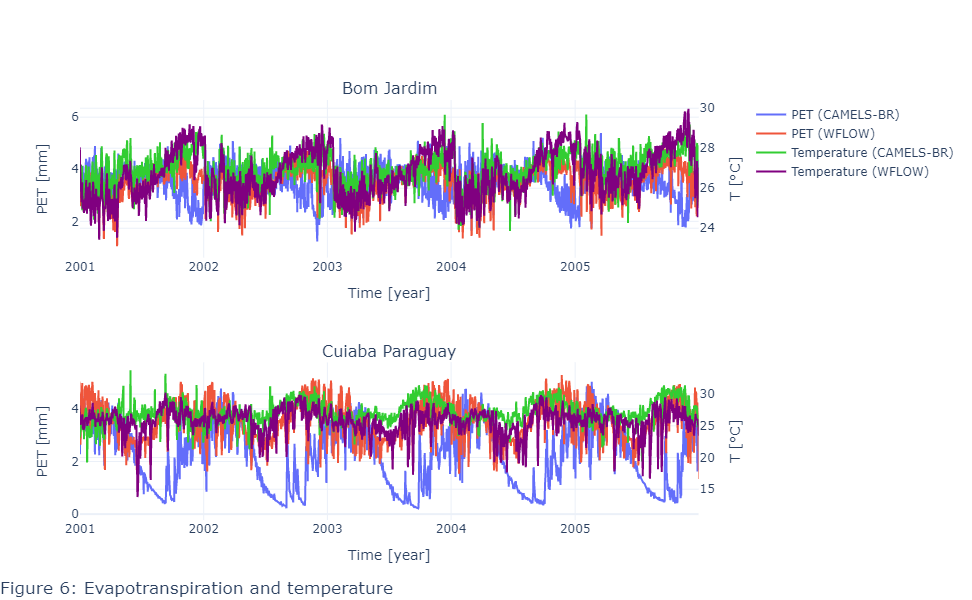

In [15]:
Observed_pet_3152 = Overview_observed_daily[1]['E']
Observed_pet_6626 = Overview_observed_daily[9]['E']
Observed_tas_3152 = Overview_observed_daily[1]['T']
Observed_tas_6626 = Overview_observed_daily[9]['T']
Model_pet_3152 = forcing_3152['pet']
Model_pet_6626 = forcing_6626['pet']
Model_tas_3152 = forcing_3152['tas']
Model_tas_6626 = forcing_6626['tas']

fig_tas = make_subplots(rows=2, cols=1, subplot_titles=("Bom Jardim", "Cuiaba Paraguay"),
                                                   specs=[[{"secondary_y": True}], 
                                                           [{"secondary_y": True}]],)

fig_tas.add_trace(go.Scatter(
    y=Observed_pet_3152,
    x=Observed_pet_3152.index,
    mode='lines',
    name='PET (CAMELS-BR)',
    marker_color = '#636EFA'
    
),secondary_y=False,row=1, col=1)

fig_tas.add_trace(go.Scatter(
    y=Model_pet_3152.values,
    x=Model_pet_3152.index,
    mode='lines',
    name='PET (WFLOW)',
    marker_color = '#EF553B'
),secondary_y=False,row=1, col=1)

fig_tas.add_trace(go.Scatter(
    y=Observed_tas_3152,
    x=Observed_tas_3152.index,
    mode='lines',
    name='Temperature (CAMELS-BR)',
    marker_color = 'limegreen',
    
    
),secondary_y=True,row=1, col=1)

fig_tas.add_trace(go.Scatter(
    y=Model_tas_3152.values,
    x=Model_tas_3152.index,
    mode='lines',
    name='Temperature (WFLOW)',
    marker_color = 'purple'
),secondary_y=True,row=1, col=1)

fig_tas.add_trace(go.Scatter(
    y=Observed_pet_6626,
    x=Observed_pet_6626.index,
    mode='lines',
    name='Gleam (CAMELS-BR)',
    marker_color = '#636EFA',
    showlegend=False
    
),secondary_y=False,row=2, col=1)

fig_tas.add_trace(go.Scatter(
    y=Model_pet_6626.values,
    x=Model_pet_6626.index,
    mode='lines',
    name='MSWEP (WFLOW)',
    marker_color = '#EF553B',
    showlegend=False
),secondary_y=False ,row=2, col=1)

fig_tas.add_trace(go.Scatter(
    y=Observed_tas_6626,
    x=Observed_tas_6626.index,
    mode='lines',
    name='Temperature (CAMELS-BR)',
    marker_color = 'limegreen',
    showlegend=False
    
),secondary_y=True, row=2, col=1)

fig_tas.add_trace(go.Scatter(
    y=Model_tas_6626.values,
    x=Model_tas_6626.index,
    mode='lines',
    name='Temperature (WFLOW)',
    marker_color = 'purple',
    showlegend=False
),secondary_y=True, row=2, col=1)

fig_tas['layout']['xaxis']['title']='Time [year]'
fig_tas['layout']['xaxis2']['title']='Time [year]'
fig_tas['layout']['yaxis']['title']='PET [mm]'
fig_tas['layout']['yaxis2']['title']='T [°C]'
fig_tas['layout']['yaxis3']['title']='PET [mm]'
fig_tas['layout']['yaxis4']['title']='T [°C]'


fig_tas.update_xaxes(range=["2001-01-01", "2005-12-31"])
#fig_pet.update_yaxes(range=["0", "6"])
fig_tas.update_layout(template='plotly_white', height=600, width=950, title = dict(x = 0, y=0.01, text = 'Figure 6: Evapotranspiration and temperature'),)
                      #legend=dict(
#        x=0.78,
#        y=1,
#        bgcolor='rgba(255, 255, 255, 0)',
#        bordercolor='rgba(255, 255, 255, 0)'
#    ),)
fig_tas.show()

<u>What do we see?<u>

Figure 6 shows two important observations. The first observation is that the temperature of both datasets are very similar in value and timing. The second observation regards the relation between PET and measured temperature. The PET used as input in WFLOW has a timing similar to the temperature of both datasets. This is a very strong indication that the potential evapotranspiration used to model our study area is not subject to timelag in comparison with actual values for evapotranspiration.
    
The above analysis leads to the conclusion that there is an observed timelag for PET generated by GLEAM in our study area. GLEAM is a model and it is possible that errors occur in difficult areas like the Amazon.  However, this PET by GLEAM is not used as input in our study and therefore has no impact on our results.  

### Water balance
Figure 7 shows the timeseries of the water balance. A value of zero means that the water balance is closed. Any other value indicates a surplus or deficit of one of the inputs or outputs of our model. The values on the y-axis are denoted in $\mu$, which is equal to $10^{-6}$. A good model must have a closed waterbalance.

In [16]:
#Discharge generated by WFLOW
run_number_3152 = '20220425_083912'
run_number_6626 = '20220425_084945'
Wb_3152 =  pd.read_csv('wflow_'+run_number_3152+'/run_default/Wat_bal.csv')
Wb_6626 =  pd.read_csv('wflow_'+run_number_6626+'/run_default/Wat_bal.csv')

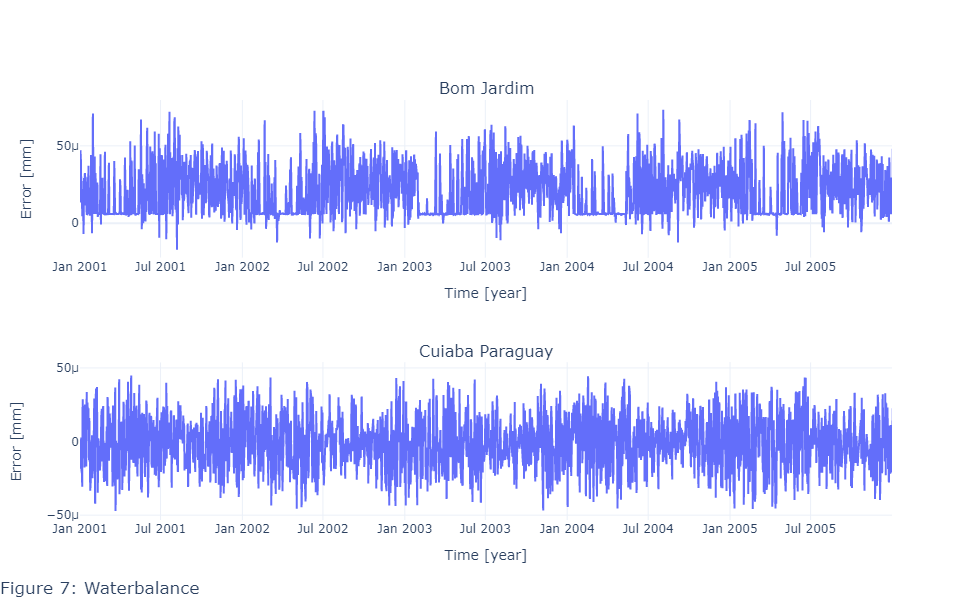

In [17]:
fig_wb = make_subplots(rows=2, cols=1, subplot_titles=("Bom Jardim", "Cuiaba Paraguay"))

fig_wb.add_trace(go.Scatter(
    y=Wb_3152['1.0'],
    x=Discharge_3152_observed.index,
    mode='lines',
    name='Q_model (WFLOW)',
    marker_color = '#636EFA',
    showlegend=False
), row=1, col=1)

fig_wb.add_trace(go.Scatter(
    y=Wb_6626['1.0'],
    x=Discharge_6626_observed.index,
    mode='lines',
    name='Q_model (WFLOW)',
    marker_color = '#636EFA',
    showlegend=False
), row=2, col=1)

fig_wb['layout']['xaxis']['title']='Time [year]'
fig_wb['layout']['xaxis2']['title']='Time [year]'
fig_wb['layout']['yaxis']['title']='Error [mm]'
fig_wb['layout']['yaxis2']['title']='Error [mm]'

fig_wb.update_xaxes(range=["2001-01-01", "2005-12-31"])
fig_wb.update_layout(template='plotly_white',height=600, width=950, title = dict(x = 0, y=0.01, text = 'Figure 7: Waterbalance'))



<u>What do we see?<u>
    
It is observed that the water balance remains close to zero for the entire timeseries. Thee deviations from zero are so small that we consider them negligible. This means the water balance of WFLOW is also considered closed. In conclusion, the water balance is not the source for the differences between modelled and observed discharge. 

### Unsaturated zone

So far we have established that our input for precipitation, potential evapotranspiration and near surface temperature are not the cause of the bad performance of our model. Therefore it is time to analyze what is happening inside the model.  Figure 8 shows the relation between discharge calculated by our model and the depth of the unsaturated zone calculated by our model. Zero unsaturated zone depth means that the entire soil is saturated. We will also look at the relation between precipitation and unsaturated zone in addition to the relation between discharge and unsaturated zone. This is shown in figure 9.


In [19]:
#Output generated by WFLOW
run_number_3152 = '20220425_083912'
run_number_6626 = '20220425_084945'

Tra_3152 = pd.read_csv('wflow_'+run_number_3152+'/run_default/Transfer.csv')
Cap_3152 = pd.read_csv('wflow_'+run_number_3152+'/run_default/Capflux.csv')
Inf_3152 = pd.read_csv('wflow_'+run_number_3152+'/run_default/Infiltration_soil.csv')
Inf_excess_3152 = pd.read_csv('wflow_'+run_number_3152+'/run_default/InfiltExcess_soil.csv')
Evap_3152 = pd.read_csv('wflow_'+run_number_3152+'/run_default/Evap_Ustore.csv')
Exfilt_3152 = pd.read_csv('wflow_'+run_number_3152+'/run_default/Exfilt_Ustore.csv')
U_store_3152 = pd.read_csv('wflow_'+run_number_3152+'/run_default/U_store.csv')
Sat_store_3152 = pd.read_csv('wflow_'+run_number_3152+'/run_default/Sat_store.csv')

Tra_6626 = pd.read_csv('wflow_'+run_number_6626+'/run_default/Transfer.csv')
Cap_6626 = pd.read_csv('wflow_'+run_number_6626+'/run_default/Capflux.csv')
Inf_6626 = pd.read_csv('wflow_'+run_number_6626+'/run_default/Infiltration_soil.csv')
Inf_excess_6626 = pd.read_csv('wflow_'+run_number_6626+'/run_default/InfiltExcess_soil.csv')
Evap_6626 = pd.read_csv('wflow_'+run_number_6626+'/run_default/Evap_Ustore.csv')
Exfilt_6626 = pd.read_csv('wflow_'+run_number_6626+'/run_default/Exfilt_Ustore.csv')
U_store_6626 = pd.read_csv('wflow_'+run_number_6626+'/run_default/U_store.csv')
Sat_store_6626 = pd.read_csv('wflow_'+run_number_6626+'/run_default/Sat_store.csv')

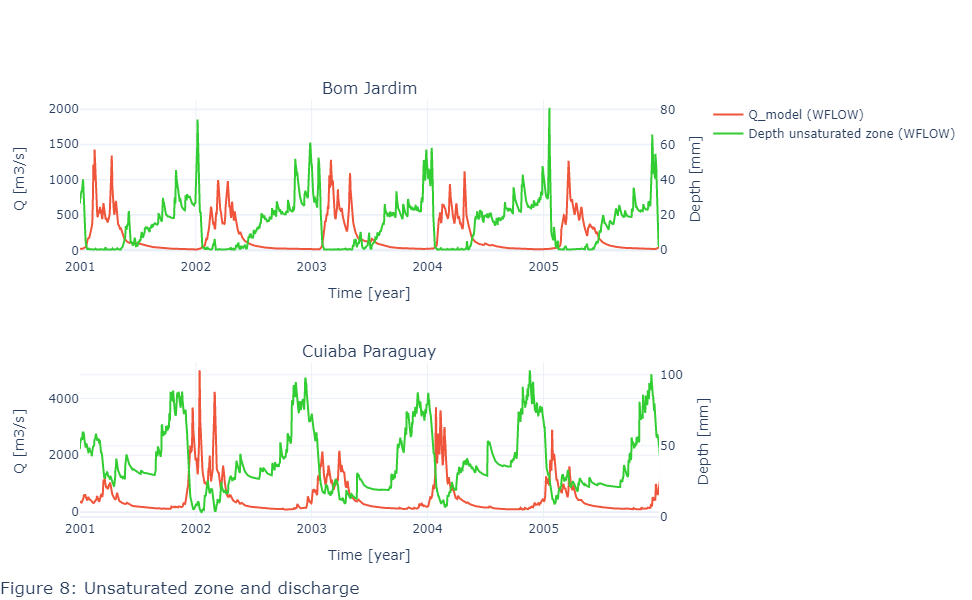

In [20]:
fig_unsat2 = make_subplots(rows=2, cols=1, subplot_titles=("Bom Jardim", "Cuiaba Paraguay"),
                                                   specs=[[{"secondary_y": True}], 
                                                           [{"secondary_y": True}]],)

fig_unsat2.add_trace(go.Scatter(
    y=Discharge_3152_cal['31520000_Q'],
    x=Discharge_3152_cal.index,
    mode='lines',
    name='Q_model (WFLOW)',
    marker_color = '#EF553B'
),secondary_y=False, row=1, col=1)

fig_unsat2.add_trace(go.Scatter(
    y= U_store_3152['1.0'],
    x=Model_pr_3152.index,
    mode='lines',
    name='Depth unsaturated zone (WFLOW)',
    marker_color = 'limegreen'
),secondary_y=True, row=1, col=1)

fig_unsat2.add_trace(go.Scatter(
    y=Discharge_6626_cal['66260001_Q'],
    x=Discharge_6626_cal.index,
    mode='lines',
    name='Q_model (WFLOW)',
    marker_color = '#EF553B',
    showlegend=False
),secondary_y=False, row=2, col=1)


fig_unsat2.add_trace(go.Scatter(
    y=U_store_6626['1.0'],
    x=Model_pr_6626.index,
    mode='lines',
    name='Q_observed (CAMELS)',
    marker_color = 'limegreen',
    showlegend=False
),secondary_y=True, row=2, col=1)

fig_unsat2['layout']['xaxis']['title']='Time [year]'
fig_unsat2['layout']['xaxis2']['title']='Time [year]'
fig_unsat2['layout']['yaxis']['title']='Q [m3/s]'
fig_unsat2['layout']['yaxis2']['title']='Depth [mm]'
fig_unsat2['layout']['yaxis3']['title']='Q [m3/s]'
fig_unsat2['layout']['yaxis4']['title']='Depth [mm]'

fig_unsat2.update_xaxes(range=["2001-01-01", "2005-12-31"])
fig_unsat2.update_layout(template='plotly_white', height=600, width=950, title = dict(x = 0, y=0.01, text = 'Figure 8: Unsaturated zone and discharge'))

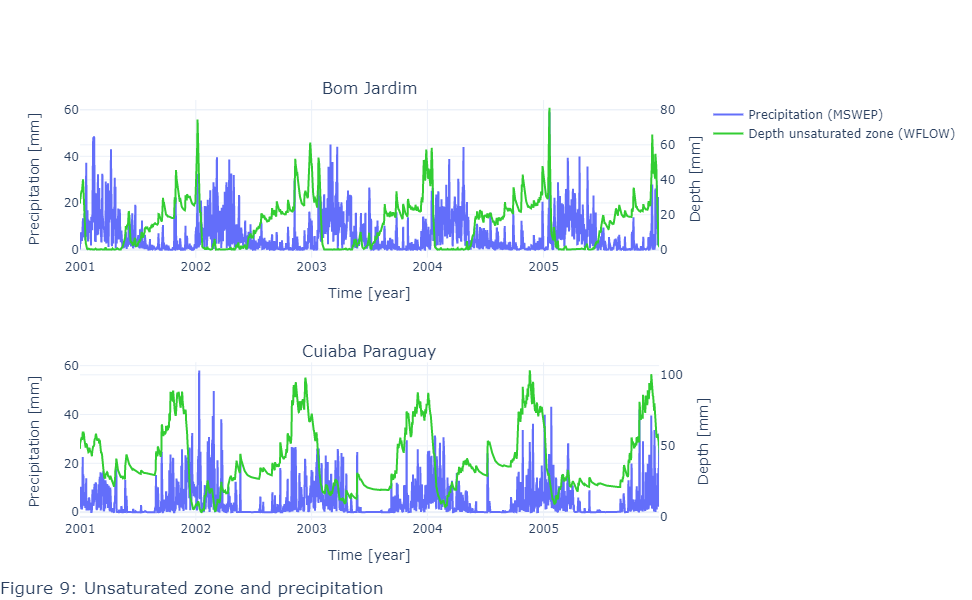

In [21]:
fig_unsat2 = make_subplots(rows=2, cols=1, subplot_titles=("Bom Jardim", "Cuiaba Paraguay"),
                                                   specs=[[{"secondary_y": True}], 
                                                           [{"secondary_y": True}]],)

fig_unsat2.add_trace(go.Scatter(
    y=Model_pr_3152,
    x=Model_pr_3152.index,
    mode='lines',
    name='Precipitation (MSWEP)',
    marker_color = '#636EFA'
),secondary_y=False, row=1, col=1)

fig_unsat2.add_trace(go.Scatter(
    y= U_store_3152['1.0'],
    x=Model_pr_3152.index,
    mode='lines',
    name='Depth unsaturated zone (WFLOW)',
    marker_color = 'limegreen'
),secondary_y=True, row=1, col=1)

fig_unsat2.add_trace(go.Scatter(
    y=Model_pr_6626,
    x=Model_pr_6626.index,
    mode='lines',
    name='Q_model (WFLOW)',
    marker_color = '#636EFA',
    showlegend=False
),secondary_y=False, row=2, col=1)


fig_unsat2.add_trace(go.Scatter(
    y=U_store_6626['1.0'],
    x=Model_pr_6626.index,
    mode='lines',
    name='Q_observed (CAMELS)',
    marker_color = 'limegreen',
    showlegend=False
),secondary_y=True, row=2, col=1)

fig_unsat2['layout']['xaxis']['title']='Time [year]'
fig_unsat2['layout']['xaxis2']['title']='Time [year]'
fig_unsat2['layout']['yaxis']['title']='Precipitation [mm]'
fig_unsat2['layout']['yaxis2']['title']='Depth [mm]'
fig_unsat2['layout']['yaxis3']['title']='Precipitation [mm]'
fig_unsat2['layout']['yaxis4']['title']='Depth [mm]'

fig_unsat2.update_xaxes(range=["2001-01-01", "2005-12-31"])
fig_unsat2.update_layout(template='plotly_white', height=600, width=950, title = dict(x = 0, y=0.01, text = 'Figure 9: Unsaturated zone and precipitation'))

<u>What do we see?<u>
    
A clear signal obtained from figure 8 is that discharge peaks occur when the depth of the unsaturated zone is close to zero. This signal makes sense as runoff reaches the river quicker when the ground is (almost) fully saturated. Runoff reaches the river quicker because there is "damping" by the soil. Also more rainfall ends up in river discharge when the ground is (almost) fully saturated due to less infiltration in comparison with an unsaturated soil. Figure 9 shows that the soil becomes more saturated (decreasing depth unsaturated zone) during precipitation events.  
    
Now we know that discharge peaks occur when the soil is saturated, it is time to look closer at what causes the peaks. Figure 10 shows the depth of the unsaturated zone, the daily infiltration and the daily excess infiltration. Excess infiltration occurs when the soil is saturated or the infiltration capacity is reached. 

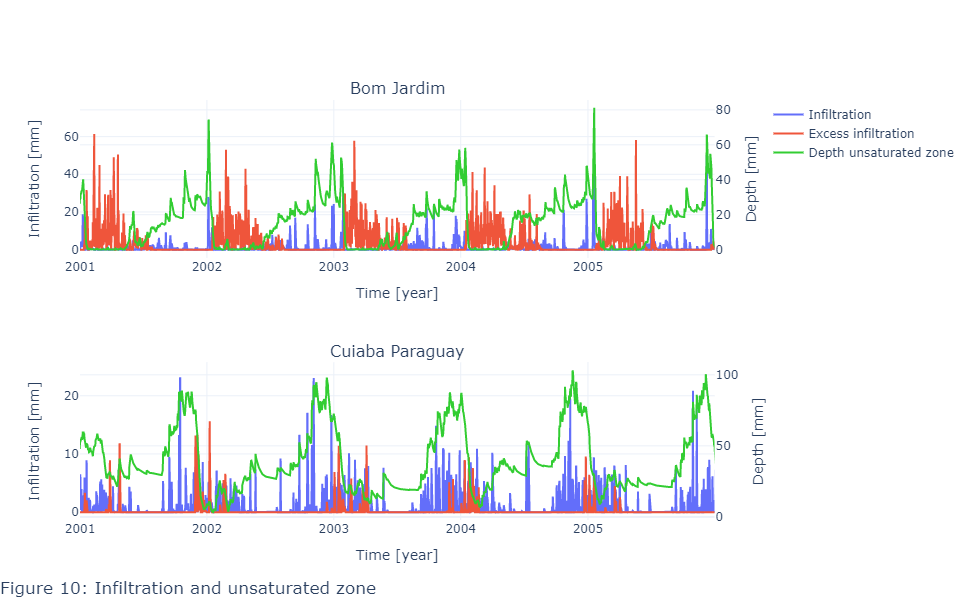

In [22]:
fig_unsat = make_subplots(rows=2, cols=1, subplot_titles=("Bom Jardim", "Cuiaba Paraguay"),
                                                   specs=[[{"secondary_y": True}], 
                                                           [{"secondary_y": True}]],)

fig_unsat.add_trace(go.Scatter(
    y=Inf_3152['1.0'],
    x=Discharge_3152_observed.index,
    mode='lines',
    name='Infiltration',
    marker_color = '#636EFA'
),secondary_y=False, row=1, col=1)

fig_unsat.add_trace(go.Scatter(
    y=Inf_excess_3152['1.0'],
    x=Discharge_3152_observed.index,
    mode='lines',
    name='Excess infiltration',
    marker_color = '#EF553B'
),secondary_y=False, row=1, col=1)

fig_unsat.add_trace(go.Scatter(
    y= U_store_3152['1.0'],
    x=Discharge_3152_observed.index,
    mode='lines',
    name='Depth unsaturated zone',
    marker_color = 'limegreen'
),secondary_y=True, row=1, col=1)

fig_unsat.add_trace(go.Scatter(
    y=Inf_6626['1.0'],
    x=Discharge_6626_observed.index,
    mode='lines',
    name='Q_model (WFLOW)',
    marker_color = '#636EFA',
    showlegend=False
),secondary_y=False, row=2, col=1)

fig_unsat.add_trace(go.Scatter(
    y=Inf_excess_6626['1.0'],
    x=Discharge_6626_observed.index,
    mode='lines',
    name='Q_observed (CAMELS)',
    marker_color = '#EF553B',
    showlegend=False
),secondary_y=False, row=2, col=1)

fig_unsat.add_trace(go.Scatter(
    y=U_store_6626['1.0'],
    x=Discharge_6626_observed.index,
    mode='lines',
    name='Q_observed (CAMELS)',
    marker_color = 'limegreen',
    showlegend=False
),secondary_y=True, row=2, col=1)

fig_unsat['layout']['xaxis']['title']='Time [year]'
fig_unsat['layout']['xaxis2']['title']='Time [year]'
fig_unsat['layout']['yaxis']['title']='Infiltration [mm]'
fig_unsat['layout']['yaxis2']['title']='Depth [mm]'
fig_unsat['layout']['yaxis3']['title']='Infiltration [mm]'
fig_unsat['layout']['yaxis4']['title']='Depth [mm]'

fig_unsat.update_xaxes(range=["2001-01-01", "2005-12-31"])
fig_unsat.update_layout(template='plotly_white', height=600, width=950,title = dict(x = 0, y=0.01, text = 'Figure 10: Infiltration and unsaturated zone'))

<u>What do we see?<u>
    
The signals in figure 10 are not the same for both catchments. In "Bom Jardim" the depth of the unsaturated zone becomes zero during precipitation events resulting in a large amount of excess infiltration. It is noticeable that the unsaturated zone fills this quickly. This can be caused by several reasons like excessive precipitation or a underestimation of the soil depth. In "Cuiaba Paraguay" excess infiltration starts occuring when the depth of the unsaturated zone starts decreasing. This is an indication that the excess infiltration is due to reaching the infiltration capacity of the soil. During heavy precipitation events the amount of rain is larger than the amount of water able to infiltrate the soil, which results in excess infiltration. 
    
We can conclude that the overestimation of discharge by WFLOW is caused by excess infiltration. However, the origin of this excess infiltration is not quite clear. Before looking into infiltration capacity and soil depth as possible reasons for the overestimation of discharge, the saturated zone is analyzed.

### Analyze results: Saturated zone

Figure 11 shows the depth of the saturated zone and discharge generated by WFLOW. A value of zero means that the soil is completely unsaturated. 

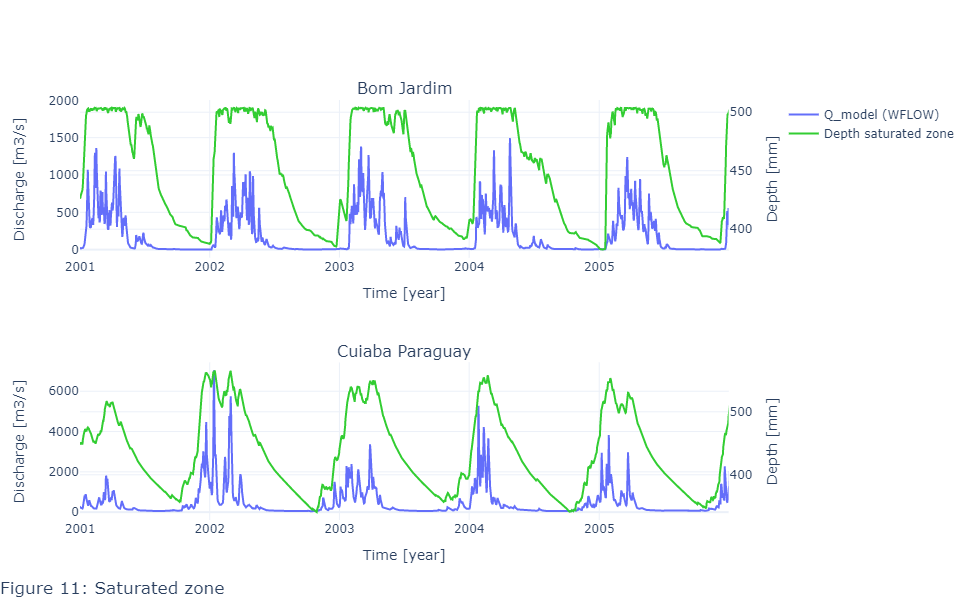

In [23]:
fig_sat = make_subplots(rows=2, cols=1, subplot_titles=("Bom Jardim", "Cuiaba Paraguay"),
                                                   specs=[[{"secondary_y": True}], 
                                                           [{"secondary_y": True}]],)

fig_sat.add_trace(go.Scatter(
    y=Discharge_3152['1.0'],
    x=Discharge_3152_observed.index,
    mode='lines',
    name='Q_model (WFLOW)',
    marker_color = '#636EFA'
), row=1, col=1)

fig_sat.add_trace(go.Scatter(
    y=Sat_store_3152['1.0'],
    x=Discharge_3152_observed.index,
    mode='lines',
    name='Depth saturated zone',
    marker_color = 'limegreen'
),secondary_y=True, row=1, col=1)

fig_sat.add_trace(go.Scatter(
    y=Discharge_6626['1.0'],
    x=Discharge_6626_observed.index,
    mode='lines',
    name='Q_model (WFLOW)',
    marker_color = '#636EFA',
    showlegend=False
), row=2, col=1)

fig_sat.add_trace(go.Scatter(
    y=Sat_store_6626['1.0'],
    x=Discharge_6626_observed.index,
    mode='lines',
    name='Saturated zone',
    marker_color = 'limegreen',
    showlegend=False
),secondary_y=True, row=2, col=1)

fig_sat['layout']['xaxis']['title']='Time [year]'
fig_sat['layout']['xaxis2']['title']='Time [year]'
fig_sat['layout']['yaxis']['title']='Discharge [m3/s]'
fig_sat['layout']['yaxis2']['title']='Depth [mm]'
fig_sat['layout']['yaxis3']['title']='Discharge [m3/s]'
fig_sat['layout']['yaxis4']['title']='Depth [mm]'

#fig_Q.update_yaxes(title= 'Q (m3/s)')
fig_sat.update_xaxes(range=["2001-01-01", "2005-12-31"])
fig_sat.update_layout(template='plotly_white', height=600, width=950,title = dict(x = 0, y=0.01, text = 'Figure 11: Saturated zone'))

<u>What do we see?<u>
    
Figure 11 shows the same signal for both catchments: Discharge peaks occur during when the saturated zone depth is increasing. This is the same kind of behaviour we earlier observed in figure 8 where we saw that discharge peaks occur when the unsaturated zone decreases. 
     

### Output after changing infiltration capacity

Figures 8 to 11 show that the overestimation of discharge origins somewhere in the soil. 

### Output after changing soil depth

### Summary